# ART HopSkipJump Attack

# Module and Packages imports

In [ ]:
from __future__ import absolute_import, division, print_function, unicode_literals

import sys
!{sys.executable} -m pip install git+https://github.com/nottombrown/imagenet_stubs
!{sys.executable} -m pip install git+https://github.com/IBM/adversarial-robustness-toolbox.git
sys.path.append("..")

%matplotlib inline

import tensorflow as tf
import imagenet_stubs
import numpy as np
import tensorflow.keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.models import Model
import tensorflow.keras.backend as k
from matplotlib import pyplot as plt
from IPython.display import clear_output
from art.estimators.classification import TensorFlowV2Classifier
from art.attacks.evasion import HopSkipJump, FastGradientMethod, ProjectedGradientDescent
from art.utils import to_categorical
import time

  Cloning https://github.com/nottombrown/imagenet_stubs to /private/var/folders/xw/yl8by7y53b31kqh45t987ry80000gn/T/pip-req-build-mjzeiq83
  Running command git clone --filter=blob:none --quiet https://github.com/nottombrown/imagenet_stubs /private/var/folders/xw/yl8by7y53b31kqh45t987ry80000gn/T/pip-req-build-mjzeiq83
  Resolved https://github.com/nottombrown/imagenet_stubs to commit 0b501276f54cbf45b8e1b67dccbdcbe51de88365
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/IBM/adversarial-robustness-toolbox.git to /private/var/folders/xw/yl8by7y53b31kqh45t987ry80000gn/T/pip-req-build-at1izavb
  Running command git clone --filter=blob:none --quiet https://github.com/IBM/adversarial-robustness-toolbox.git /private/var/folders/xw/yl8by7y53b31kqh45t987ry80000gn/T/pip-req-build-at1izavb
  Resolved https://github.com/IBM/adversarial-robustness-toolbox.git to commit 6410aa1d35fb38c638fcfcdb9276c85a0a2e558e
  Installing build dependencies ... done
  Getting requirements to 

/Users/orbit/anaconda3/envs/cv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Model Definition

In [ ]:
# Mean ImageNet values
mean_imagenet = np.zeros([224, 224, 3])
mean_imagenet[...,0].fill(103.939)
mean_imagenet[...,1].fill(116.779)
mean_imagenet[...,2].fill(123.68)

# Load ResNet50 model
model = ResNet50(weights='imagenet')
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Number of classes and input shape
nb_classes = 1000
input_shape = (224, 224, 3)

# Create ART TensorFlow V2 classifier
classifier = TensorFlowV2Classifier(
    model=model,
    nb_classes=nb_classes,
    input_shape=input_shape,
    clip_values=(0, 255),
    preprocessing=(mean_imagenet, np.ones([224, 224, 3])),
    loss_object=tf.keras.losses.CategoricalCrossentropy()
)

2024-08-21 11:53:08.373315: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M3
2024-08-21 11:53:08.373335: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2024-08-21 11:53:08.373340: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2024-08-21 11:53:08.373354: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-08-21 11:53:08.373364: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


# Get Target and Init Images

Target image is:  105


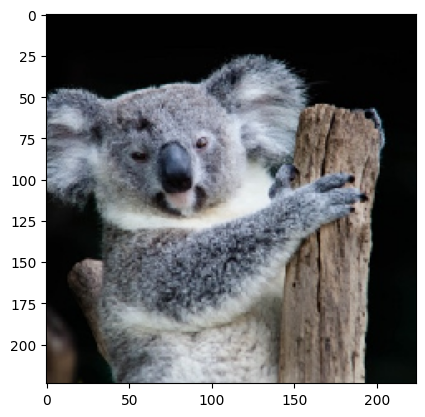

Init image is:  866


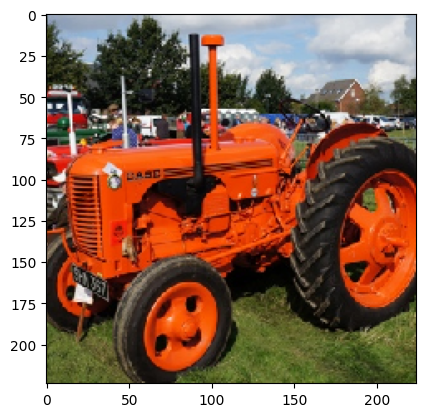

In [ ]:
# Define the image names
target_image_name = 'koala.jpg'
init_image_name = 'tractor.jpg'

# Define a function to load images based on file names
def load_image(image_path, target_name, init_name):
    target_image = None
    init_image = None
    for path in image_path:
        if path.endswith(target_name):
            target_image = image.load_img(path, target_size=(224, 224))
            target_image = image.img_to_array(target_image)
        if path.endswith(init_name):
            init_image = image.load_img(path, target_size=(224, 224))
            init_image = image.img_to_array(init_image)
    return target_image, init_image

# Load images
image_paths = imagenet_stubs.get_image_paths()  # Ensure this function returns a list of paths
target_image, init_image = load_image(image_paths, target_image_name, init_image_name)

# Check if images are loaded
if target_image is not None and init_image is not None:
    # Predict and display results
    target_pred = np.argmax(classifier.predict(np.array([target_image]))[0])
    print("Target image is: ", target_pred)
    plt.imshow(target_image.astype(np.uint8))
    plt.show()

    init_pred = np.argmax(classifier.predict(np.array([init_image]))[0])
    print("Init image is: ", init_pred)
    plt.imshow(init_image.astype(np.uint8))
    plt.show()
else:
    print("Images not found. Please check the image paths.")

# HopSkipJump Targeted Attack

## Without Masking

HopSkipJump: 100%|██████████| 1/1 [00:00<00:00, 3731.59it/s]


Step 0: Non-Ensemble L2 error 44265.72265625, Class 866, Non-Ensemble Time 0.2377 seconds
Step 0: Ensemble L2 error 44265.7265625, Class 730, Ensemble Time 1.9225 seconds


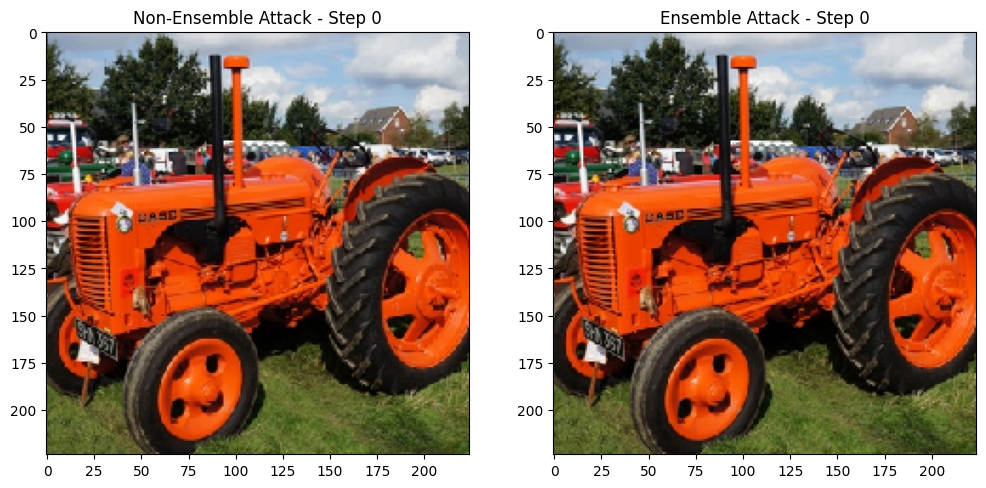

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.25s/it]


Step 10: Non-Ensemble L2 error 16704.876953125, Class 866, Non-Ensemble Time 17.5278 seconds
Step 10: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.1682 seconds


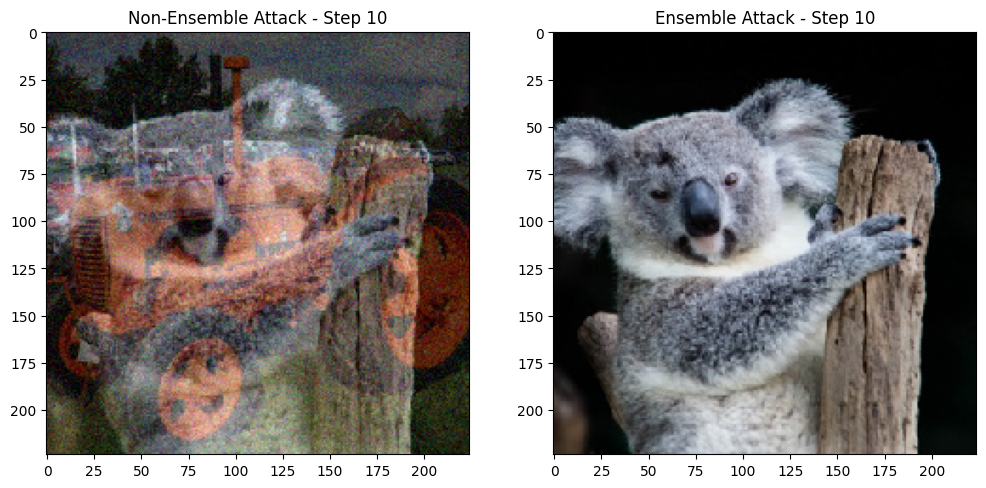

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.25s/it]


Step 20: Non-Ensemble L2 error 14189.4541015625, Class 866, Non-Ensemble Time 19.1631 seconds
Step 20: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.1503 seconds


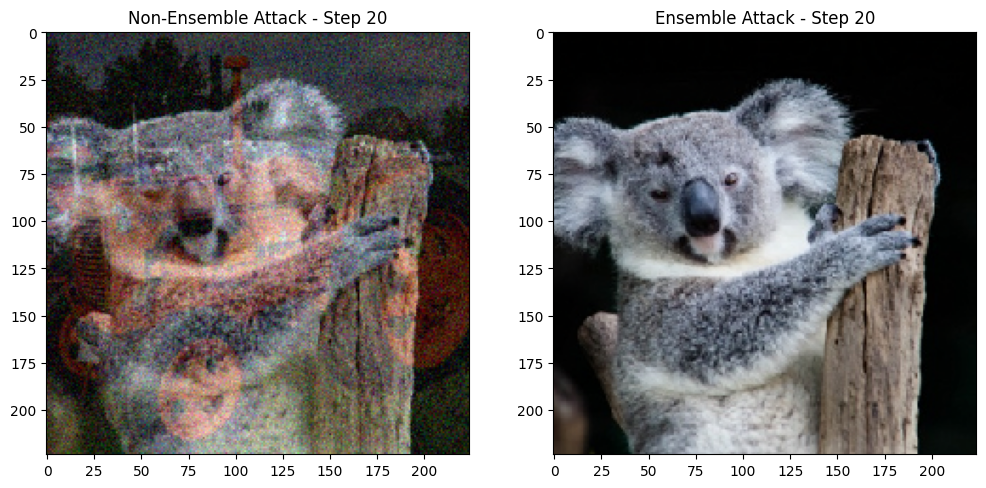

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.17s/it]


Step 30: Non-Ensemble L2 error 11680.744140625, Class 866, Non-Ensemble Time 19.9096 seconds
Step 30: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.1242 seconds


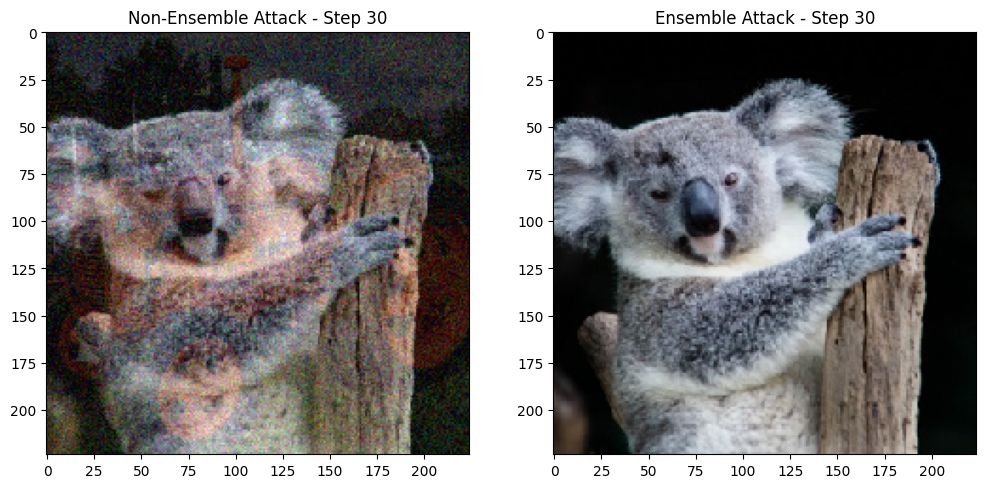

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.14s/it]


Step 40: Non-Ensemble L2 error 9009.9609375, Class 866, Non-Ensemble Time 20.5348 seconds
Step 40: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.0634 seconds


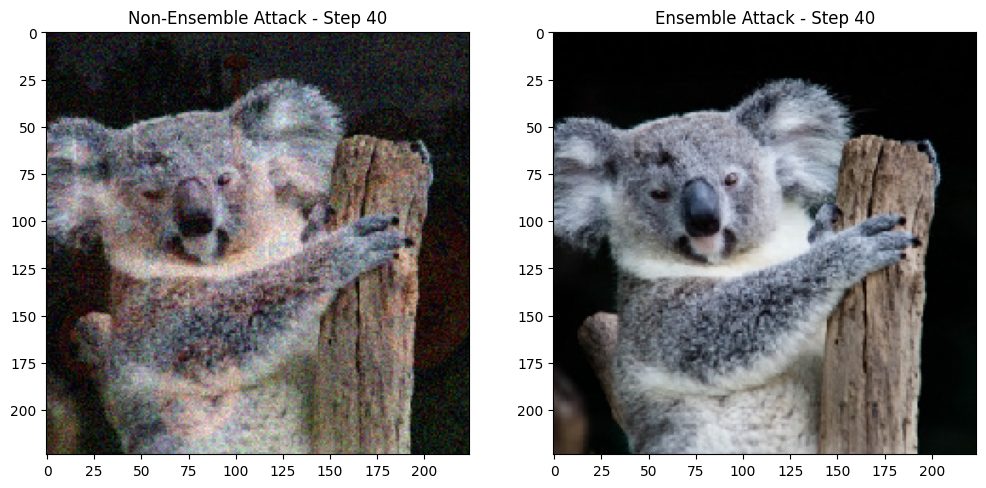

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.14s/it]


Step 50: Non-Ensemble L2 error 7781.28271484375, Class 866, Non-Ensemble Time 21.6762 seconds
Step 50: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.0775 seconds


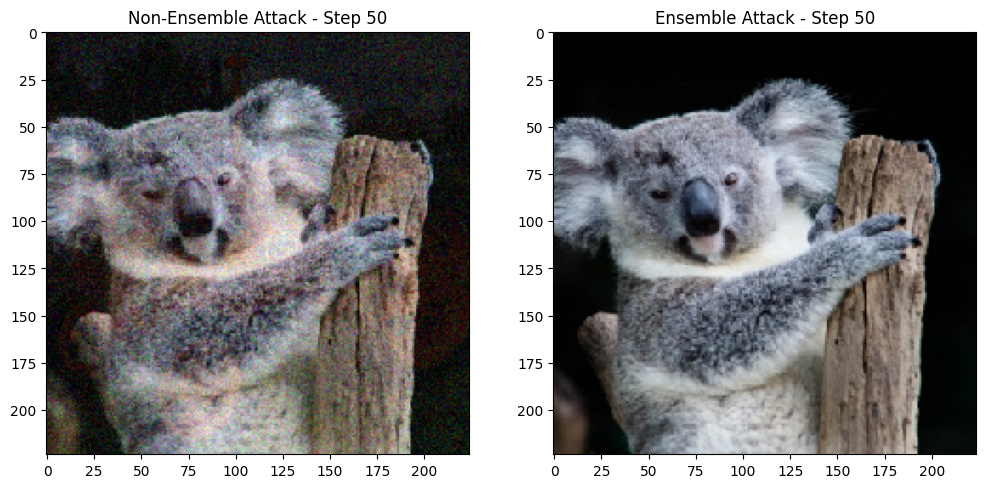

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.46s/it]


Step 60: Non-Ensemble L2 error 6533.3037109375, Class 866, Non-Ensemble Time 25.0192 seconds
Step 60: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.3822 seconds


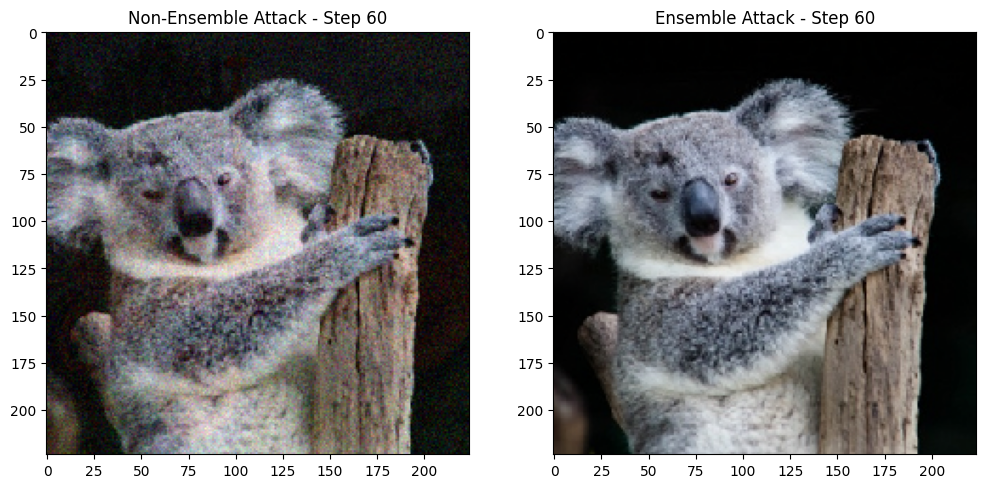

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.36s/it]


Step 70: Non-Ensemble L2 error 5381.19189453125, Class 866, Non-Ensemble Time 25.7924 seconds
Step 70: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.3394 seconds


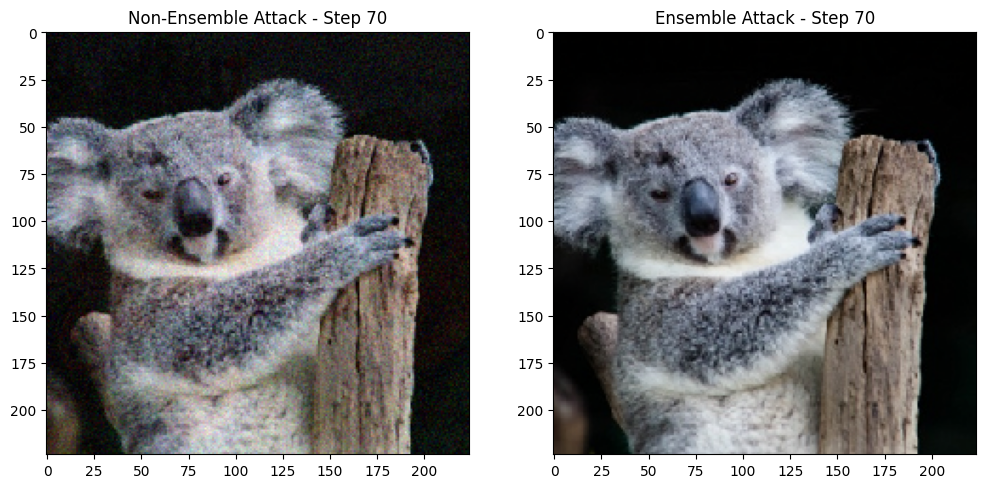

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.04s/it]


Step 80: Non-Ensemble L2 error 4501.1181640625, Class 866, Non-Ensemble Time 24.7584 seconds
Step 80: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.8876 seconds


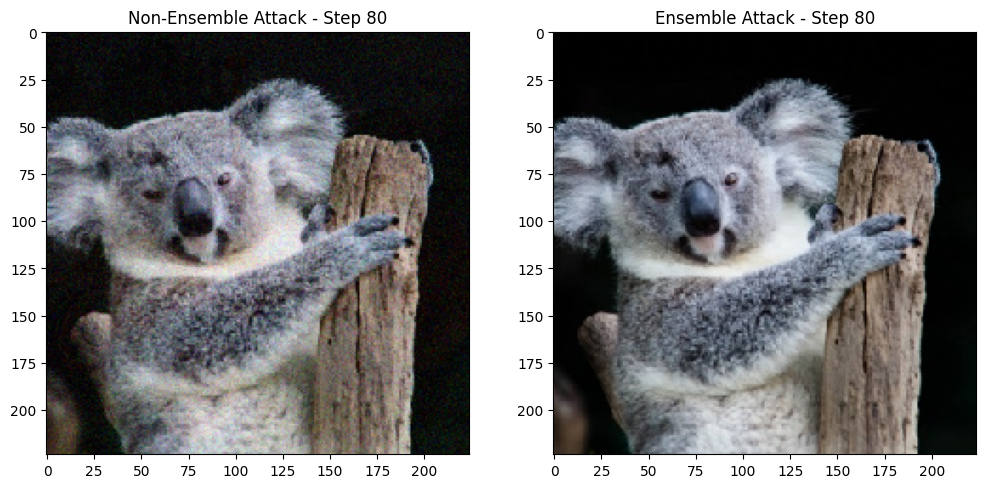

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.06s/it]


Step 90: Non-Ensemble L2 error 3918.187255859375, Class 866, Non-Ensemble Time 24.2346 seconds
Step 90: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9345 seconds


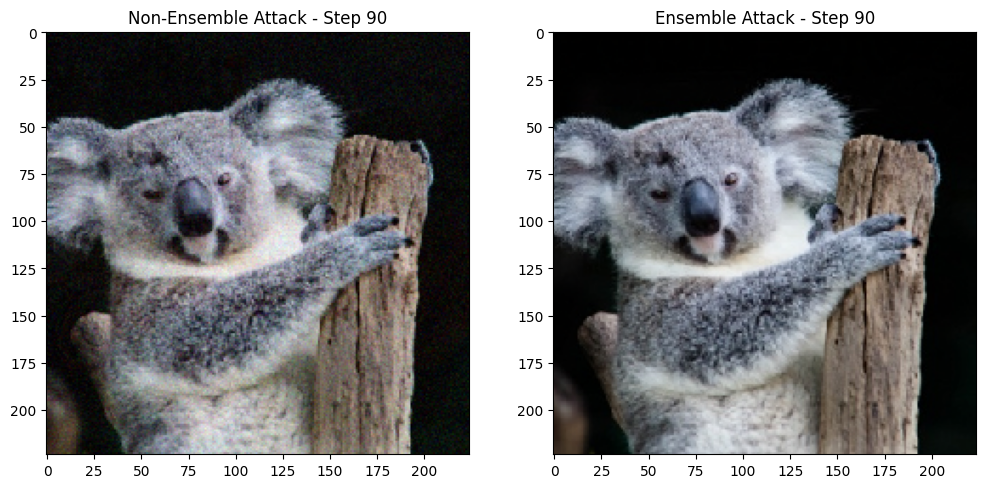

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.07s/it]


Step 100: Non-Ensemble L2 error 3552.353759765625, Class 866, Non-Ensemble Time 24.8061 seconds
Step 100: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9337 seconds


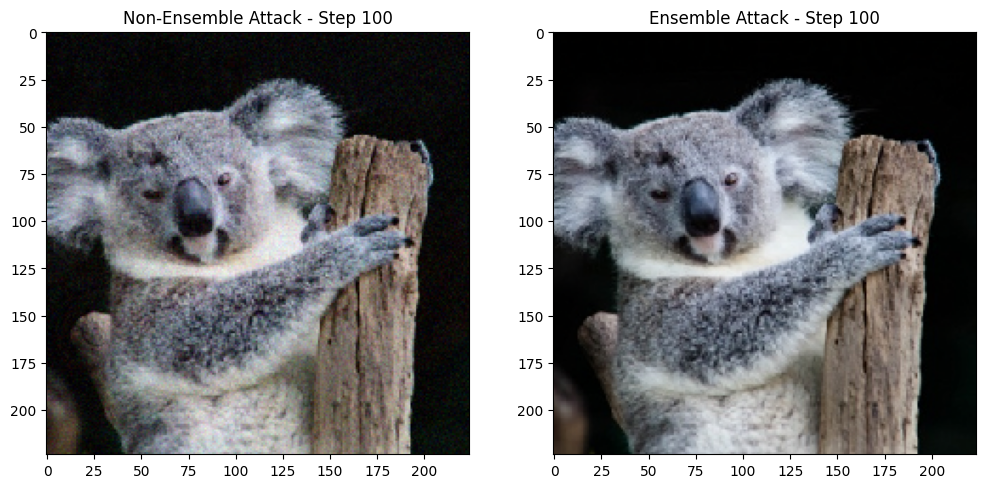

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.36s/it]


Step 110: Non-Ensemble L2 error 3122.581298828125, Class 866, Non-Ensemble Time 25.5177 seconds
Step 110: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.3484 seconds


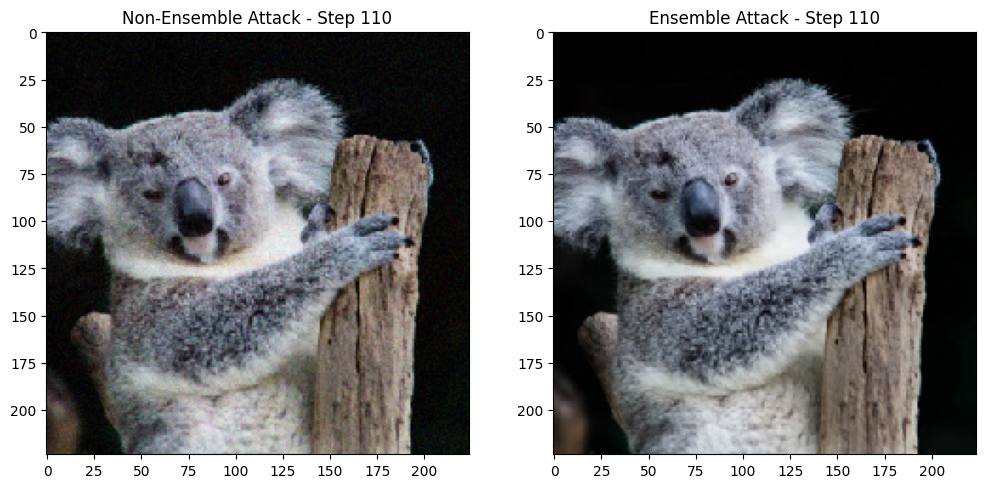

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.09s/it]


Step 120: Non-Ensemble L2 error 2786.34228515625, Class 866, Non-Ensemble Time 30.0954 seconds
Step 120: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9675 seconds


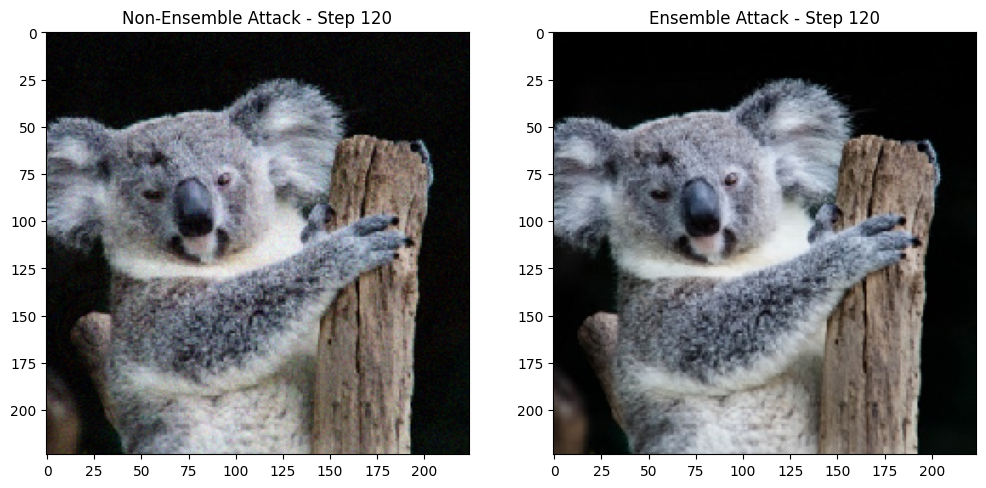

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.07s/it]


Step 130: Non-Ensemble L2 error 2538.563232421875, Class 866, Non-Ensemble Time 28.2888 seconds
Step 130: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9437 seconds


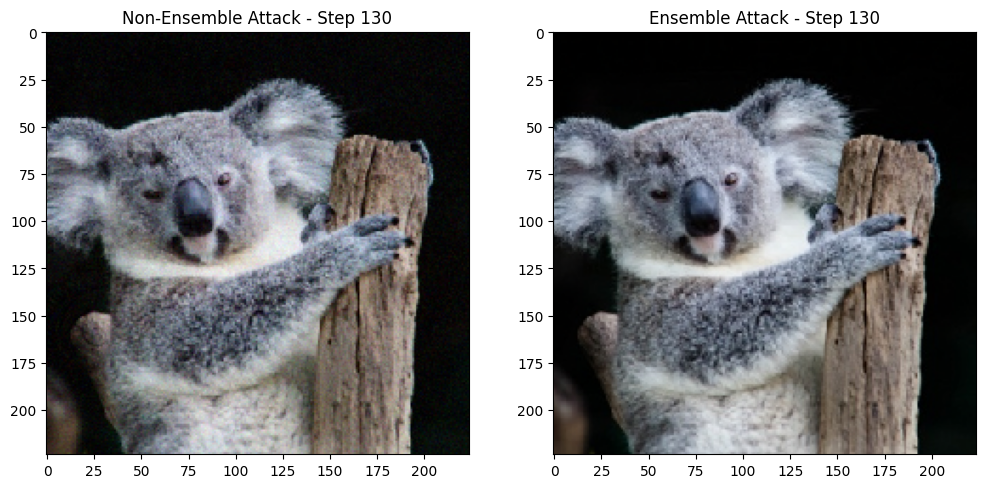

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.99s/it]


Step 140: Non-Ensemble L2 error 2305.262939453125, Class 866, Non-Ensemble Time 30.1965 seconds
Step 140: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.9247 seconds


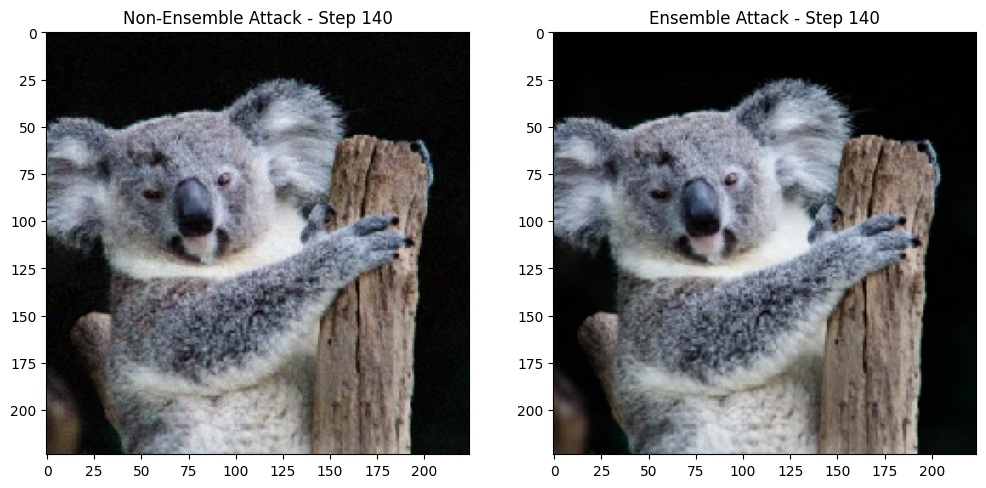

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.27s/it]


Step 150: Non-Ensemble L2 error 2122.23974609375, Class 866, Non-Ensemble Time 30.9288 seconds
Step 150: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.1882 seconds


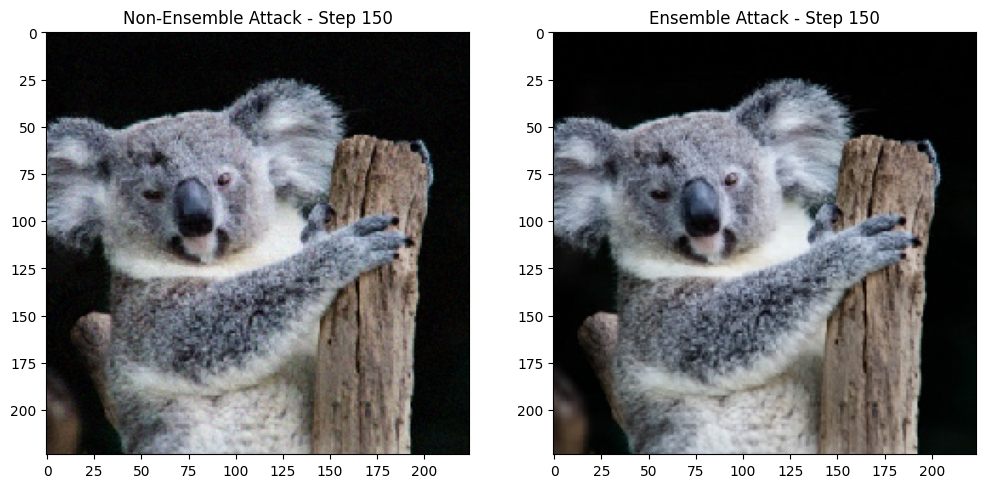

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.09s/it]


Step 160: Non-Ensemble L2 error 1924.977783203125, Class 866, Non-Ensemble Time 29.6955 seconds
Step 160: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.0090 seconds


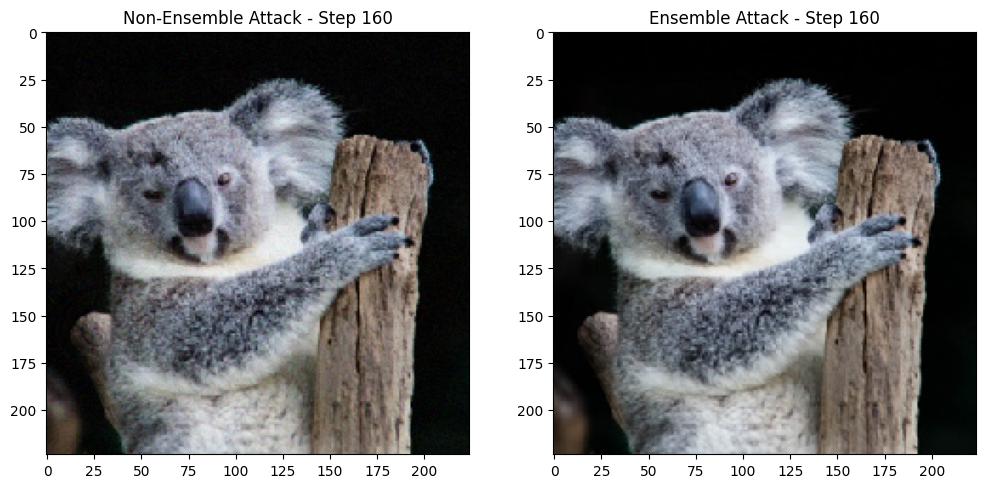

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.07s/it]


Step 170: Non-Ensemble L2 error 1789.394775390625, Class 866, Non-Ensemble Time 28.9871 seconds
Step 170: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9713 seconds


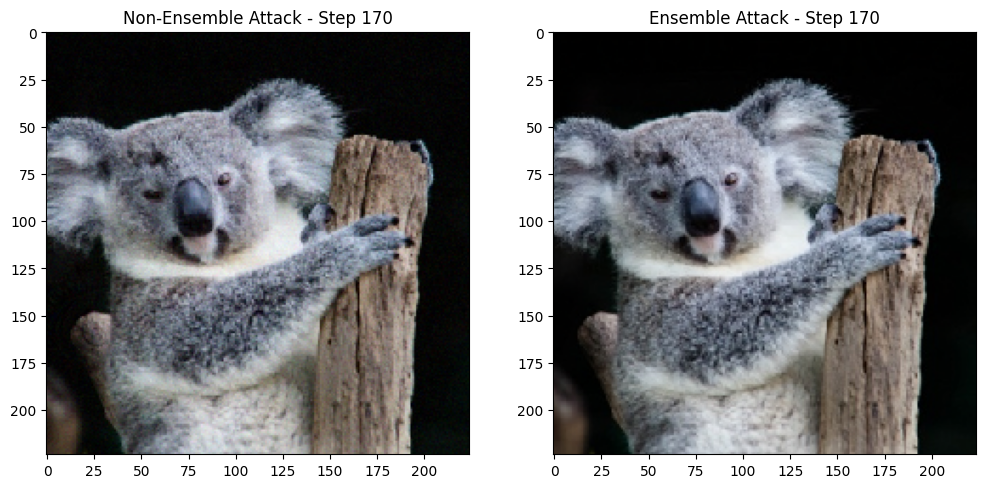

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.08s/it]


Step 180: Non-Ensemble L2 error 1663.3956298828125, Class 866, Non-Ensemble Time 31.0687 seconds
Step 180: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9844 seconds


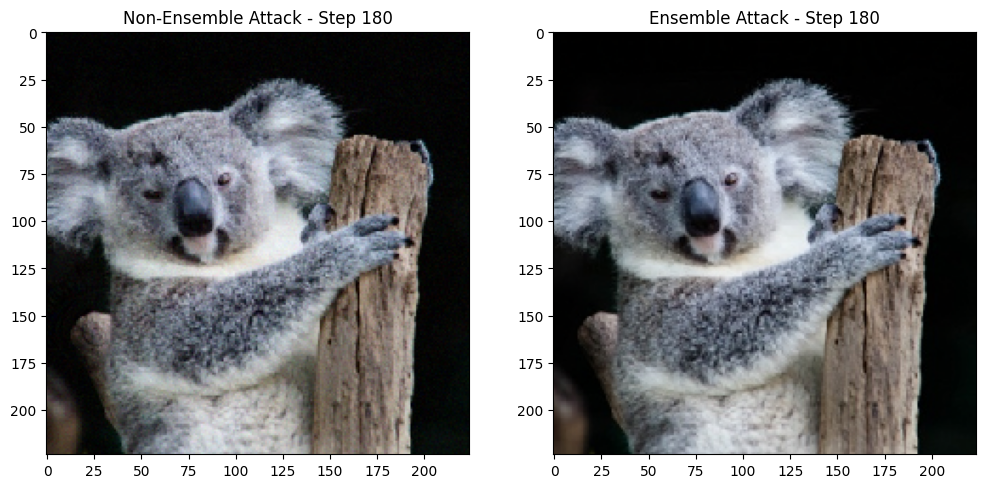

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.08s/it]


Step 190: Non-Ensemble L2 error 1541.1163330078125, Class 866, Non-Ensemble Time 29.9865 seconds
Step 190: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9371 seconds


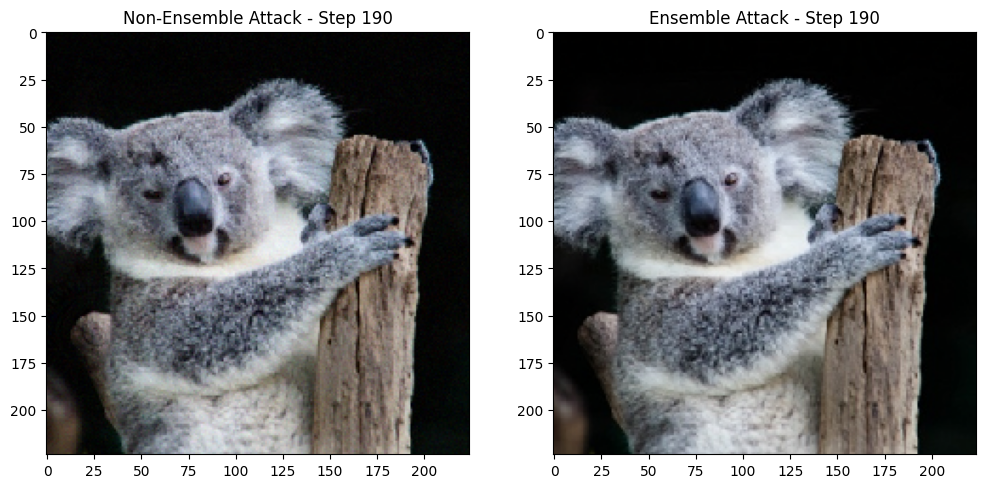

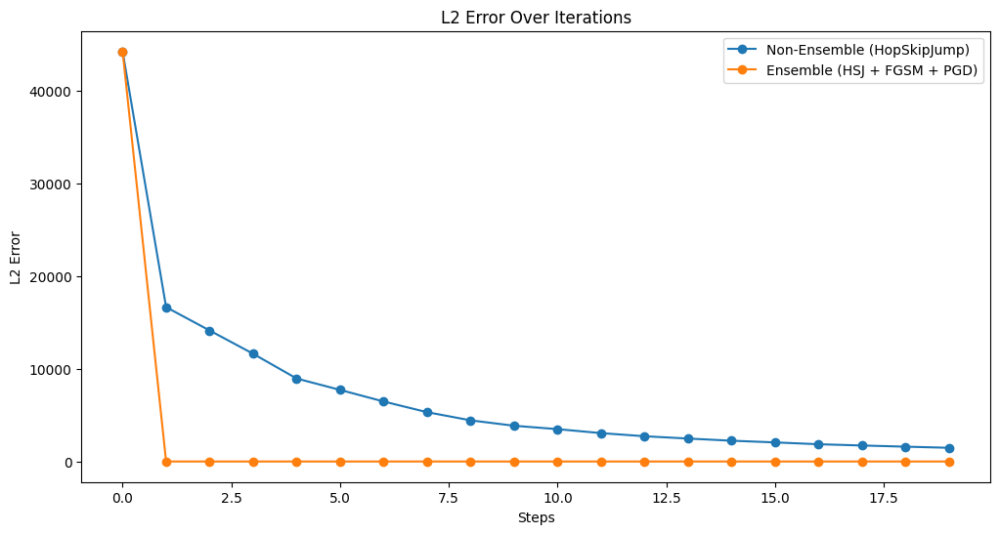

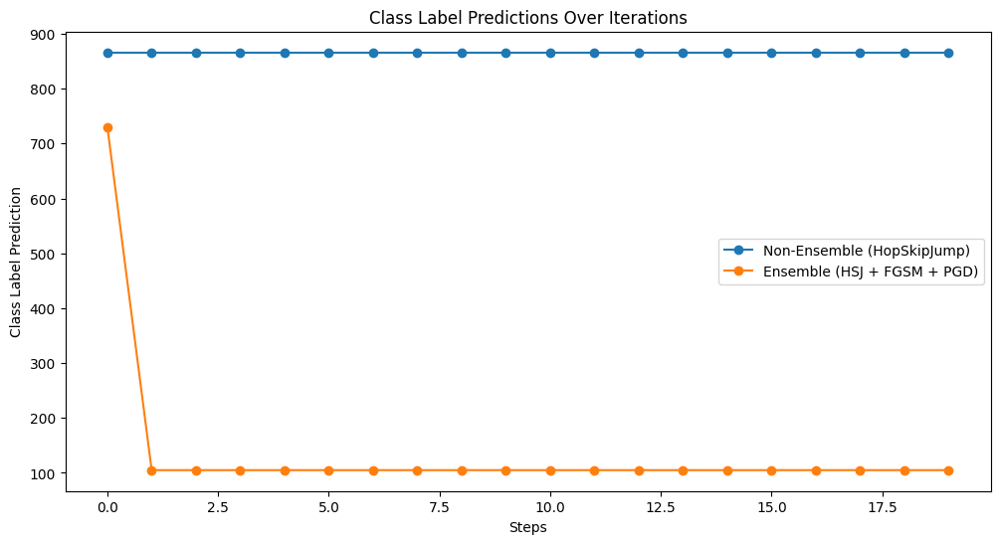

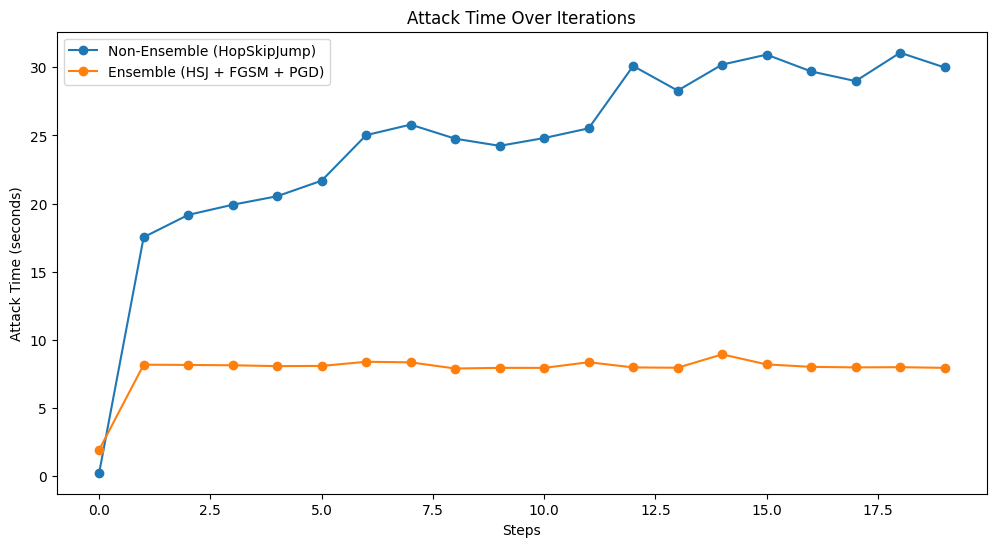

In [ ]:
attack_hopskipjump = HopSkipJump(classifier=classifier, targeted=True, max_iter=0, max_eval=1000, init_eval=10)
attack_fgsm = FastGradientMethod(estimator=classifier, eps=0.1)
attack_pgd = ProjectedGradientDescent(estimator=classifier, eps=0.1, eps_step=0.01, max_iter=10)

# Attack Parameters
hsj_max_iter = 10  # Iteration step for HopSkipJump
num_steps = 20  # Number of steps to iterate

# For ensemble attack (HopSkipJump + FGSM + PGD)
x_adv_ensemble = np.array([init_image])

# For non-ensemble attack (HopSkipJump only)
x_adv_non_ensemble = np.array([init_image])

# Data storage for plotting
errors_ensemble = []
errors_non_ensemble = []
class_labels_ensemble = []
class_labels_non_ensemble = []
times_ensemble = []
times_non_ensemble = []

# Iterative attack process
for i in range(num_steps):
    # Non-Ensemble Attack: HopSkipJump only
    start_time_non_ensemble = time.time()
    x_adv_non_ensemble = attack_hopskipjump.generate(x=np.array([target_image]), y=to_categorical([866], 1000), x_adv_init=x_adv_non_ensemble, resume=True)
    end_time_non_ensemble = time.time()
    time_non_ensemble = end_time_non_ensemble - start_time_non_ensemble
    
    # Ensemble Attack: HopSkipJump + FGSM + PGD
    start_time_ensemble = time.time()
    x_adv_ensemble = attack_hopskipjump.generate(x=np.array([target_image]), y=to_categorical([866], 1000), x_adv_init=x_adv_ensemble, resume=True)
    x_adv_ensemble = attack_fgsm.generate(x=x_adv_ensemble)
    x_adv_ensemble = attack_pgd.generate(x=x_adv_ensemble)
    end_time_ensemble = time.time()
    time_ensemble = end_time_ensemble - start_time_ensemble
    
    # Calculate L2 error
    l2_error_non_ensemble = np.linalg.norm(np.reshape(x_adv_non_ensemble[0] - target_image, [-1]))
    l2_error_ensemble = np.linalg.norm(np.reshape(x_adv_ensemble[0] - target_image, [-1]))
    
    # Get class label predictions
    class_label_non_ensemble = np.argmax(classifier.predict(x_adv_non_ensemble)[0])
    class_label_ensemble = np.argmax(classifier.predict(x_adv_ensemble)[0])
    
    # Store metrics
    errors_non_ensemble.append(l2_error_non_ensemble)
    errors_ensemble.append(l2_error_ensemble)
    class_labels_non_ensemble.append(class_label_non_ensemble)
    class_labels_ensemble.append(class_label_ensemble)
    times_non_ensemble.append(time_non_ensemble)
    times_ensemble.append(time_ensemble)
    
    # Print out progress
    print(f"Step {i * hsj_max_iter}: Non-Ensemble L2 error {l2_error_non_ensemble}, Class {class_label_non_ensemble}, Non-Ensemble Time {time_non_ensemble:.4f} seconds")
    print(f"Step {i * hsj_max_iter}: Ensemble L2 error {l2_error_ensemble}, Class {class_label_ensemble}, Ensemble Time {time_ensemble:.4f} seconds")
    
    # Show images
    plt.figure(figsize=(12, 6))
    
    plt.subplot(1, 2, 1)
    plt.title(f"Non-Ensemble Attack - Step {i * hsj_max_iter}")
    plt.imshow(x_adv_non_ensemble[0].astype(np.uint8))
    
    plt.subplot(1, 2, 2)
    plt.title(f"Ensemble Attack - Step {i * hsj_max_iter}")
    plt.imshow(x_adv_ensemble[0].astype(np.uint8))
    
    plt.show(block=False)
    
    # Increment HopSkipJump max iterations
    attack_hopskipjump.max_iter = hsj_max_iter

# Plotting L2 Error Comparison
plt.figure(figsize=(12, 6))
plt.plot(range(num_steps), errors_non_ensemble, label='Non-Ensemble (HopSkipJump)', marker='o')
plt.plot(range(num_steps), errors_ensemble, label='Ensemble (HSJ + FGSM + PGD)', marker='o')
plt.xlabel('Steps')
plt.ylabel('L2 Error')
plt.title('L2 Error Over Iterations')
plt.legend()
plt.show()

# Plotting Class Label Predictions
plt.figure(figsize=(12, 6))
plt.plot(range(num_steps), class_labels_non_ensemble, label='Non-Ensemble (HopSkipJump)', marker='o')
plt.plot(range(num_steps), class_labels_ensemble, label='Ensemble (HSJ + FGSM + PGD)', marker='o')
plt.xlabel('Steps')
plt.ylabel('Class Label Prediction')
plt.title('Class Label Predictions Over Iterations')
plt.legend()
plt.show()

# Plotting Attack Time Comparison
plt.figure(figsize=(12, 6))
plt.plot(range(num_steps), times_non_ensemble, label='Non-Ensemble (HopSkipJump)', marker='o')
plt.plot(range(num_steps), times_ensemble, label='Ensemble (HSJ + FGSM + PGD)', marker='o')
plt.xlabel('Steps')
plt.ylabel('Attack Time (seconds)')
plt.title('Attack Time Over Iterations')
plt.legend()
plt.show()

## With Masking

HopSkipJump: 100%|██████████| 1/1 [00:00<00:00, 3269.14it/s]


Step 0: Non-Ensemble L2 error 41991.25390625, Class 866, Non-Ensemble Time 0.1871 seconds
Step 0: Ensemble L2 error 41990.7421875, Class 866, Ensemble Time 1.8327 seconds


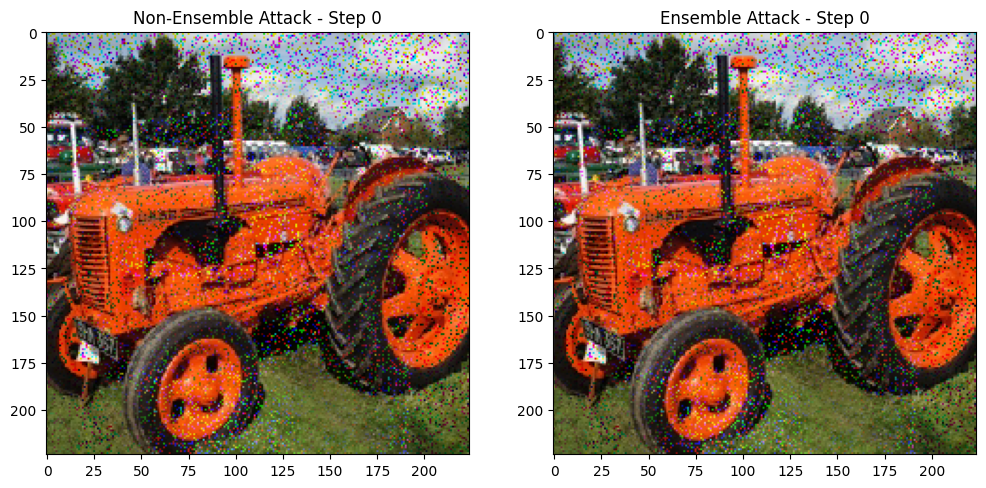

HopSkipJump: 100%|██████████| 1/1 [00:16<00:00, 16.58s/it]


Step 10: Non-Ensemble L2 error 21231.416015625, Class 866, Non-Ensemble Time 15.1763 seconds
Step 10: Ensemble L2 error 18143.6328125, Class 791, Ensemble Time 18.5720 seconds


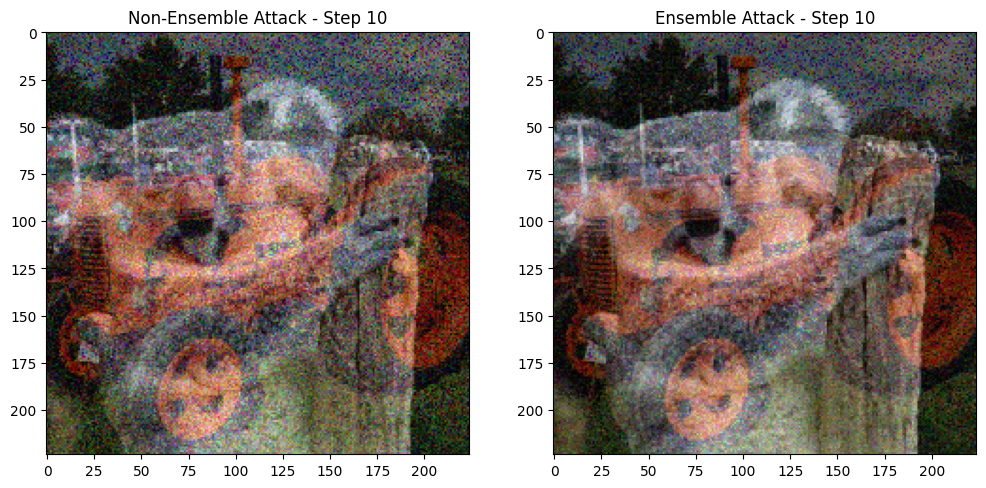

HopSkipJump: 100%|██████████| 1/1 [00:05<00:00,  5.86s/it]


Step 20: Non-Ensemble L2 error 18543.80078125, Class 866, Non-Ensemble Time 18.0642 seconds
Step 20: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.7323 seconds


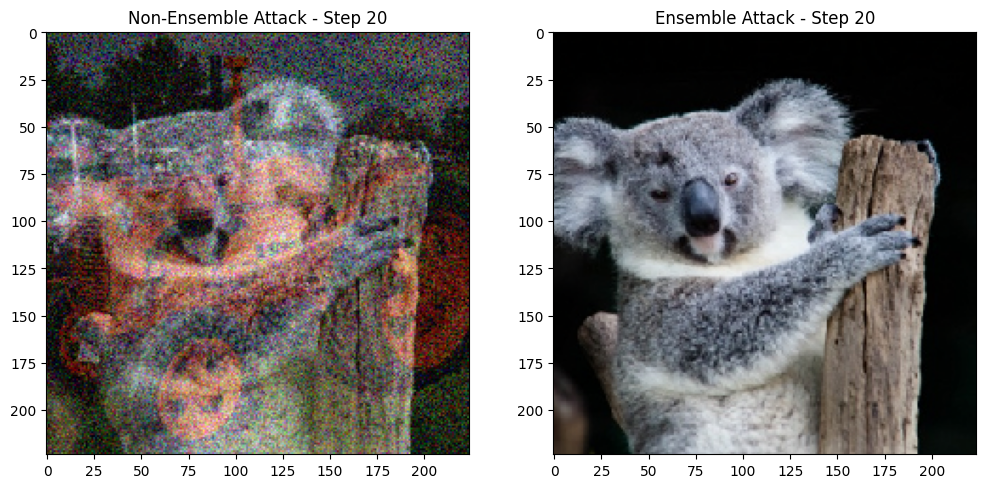

HopSkipJump: 100%|██████████| 1/1 [00:05<00:00,  5.89s/it]
                                     2024-08-21 12:48:38.576902: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Step 30: Non-Ensemble L2 error 15091.802734375, Class 866, Non-Ensemble Time 19.0313 seconds
Step 30: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.7838 seconds


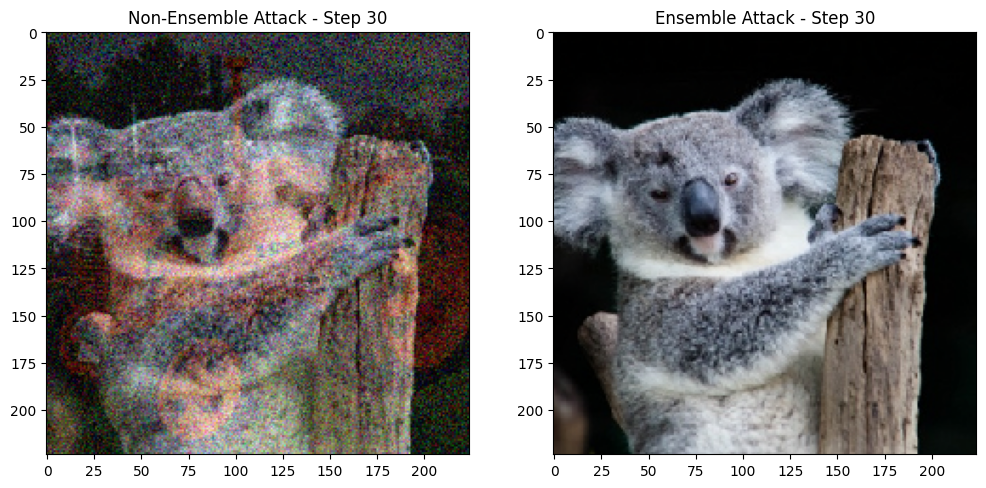

HopSkipJump: 100%|██████████| 1/1 [00:05<00:00,  5.87s/it]


Step 40: Non-Ensemble L2 error 13471.5146484375, Class 866, Non-Ensemble Time 19.8458 seconds
Step 40: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.7411 seconds


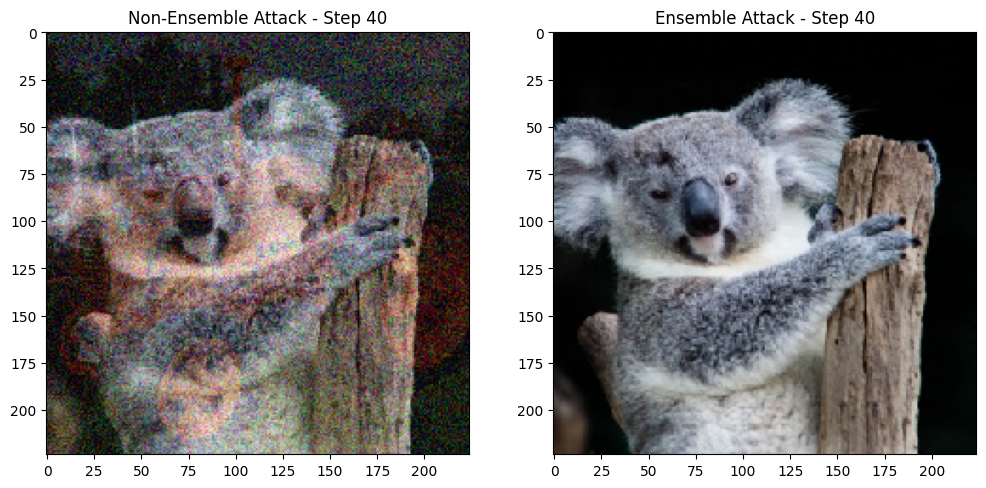

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.05s/it]


Step 50: Non-Ensemble L2 error 11939.958984375, Class 866, Non-Ensemble Time 21.7441 seconds
Step 50: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9473 seconds


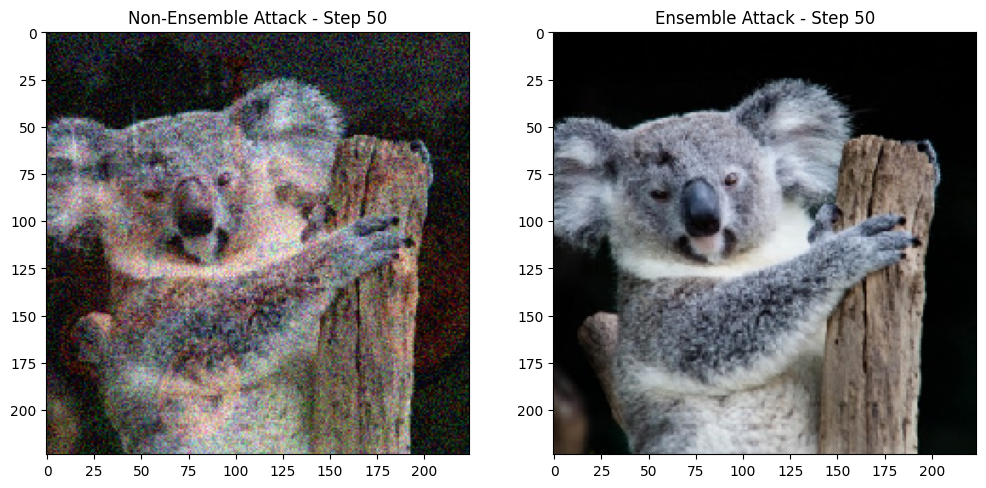

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.06s/it]


Step 60: Non-Ensemble L2 error 9633.4658203125, Class 866, Non-Ensemble Time 22.9922 seconds
Step 60: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9736 seconds


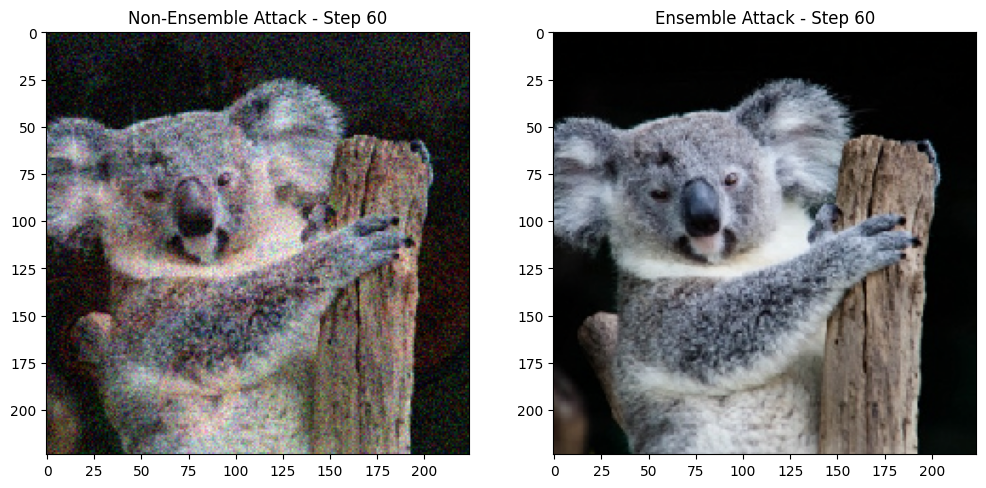

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.06s/it]


Step 70: Non-Ensemble L2 error 7543.66064453125, Class 866, Non-Ensemble Time 23.0629 seconds
Step 70: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9222 seconds


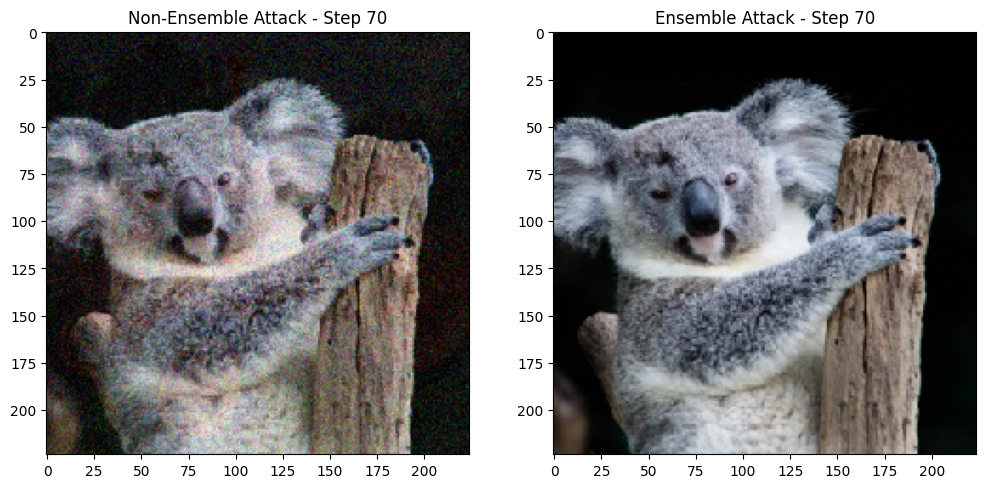

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.07s/it]


Step 80: Non-Ensemble L2 error 6368.73291015625, Class 866, Non-Ensemble Time 23.6819 seconds
Step 80: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9581 seconds


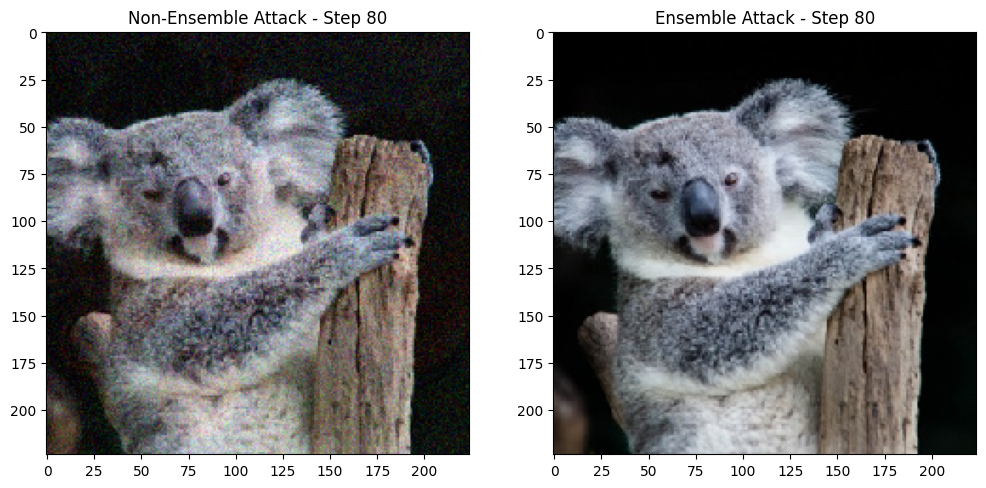

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.83s/it]


Step 90: Non-Ensemble L2 error 5290.521484375, Class 866, Non-Ensemble Time 25.2605 seconds
Step 90: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.8161 seconds


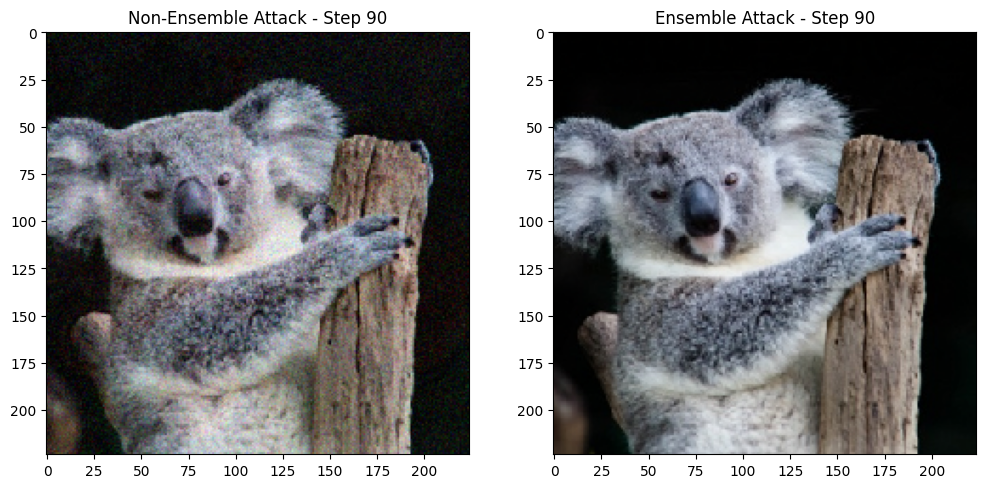

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.33s/it]


Step 100: Non-Ensemble L2 error 4560.24169921875, Class 866, Non-Ensemble Time 29.0405 seconds
Step 100: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.2320 seconds


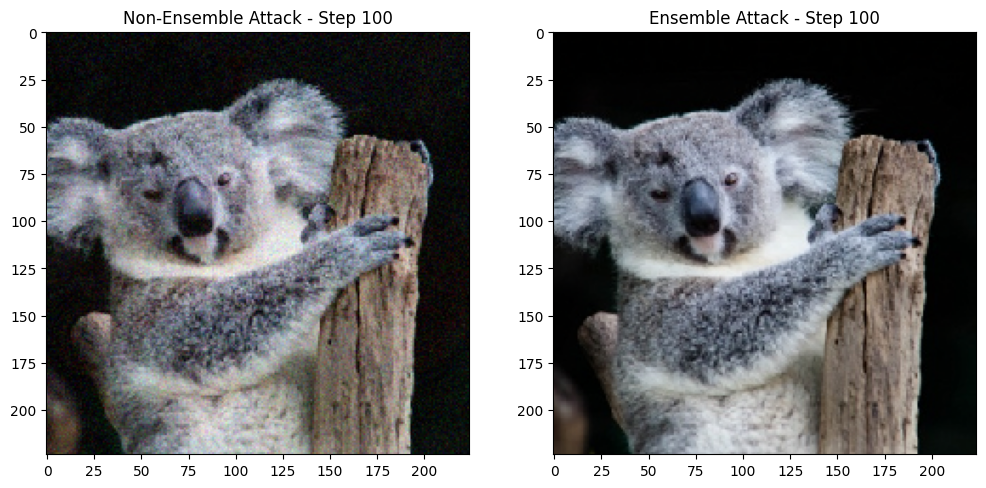

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.09s/it]


Step 110: Non-Ensemble L2 error 3923.52783203125, Class 866, Non-Ensemble Time 27.4232 seconds
Step 110: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 7.9896 seconds


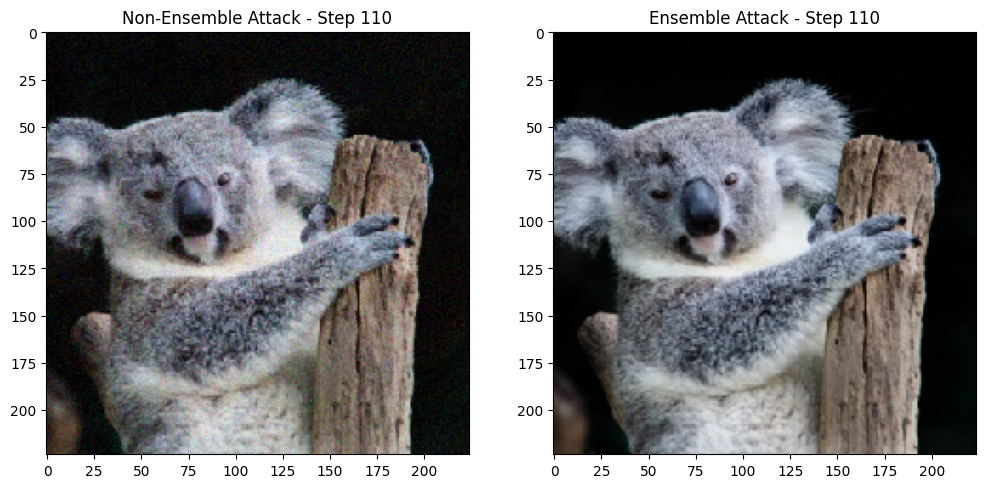

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.31s/it]


Step 120: Non-Ensemble L2 error 3409.59814453125, Class 866, Non-Ensemble Time 29.2977 seconds
Step 120: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.2069 seconds


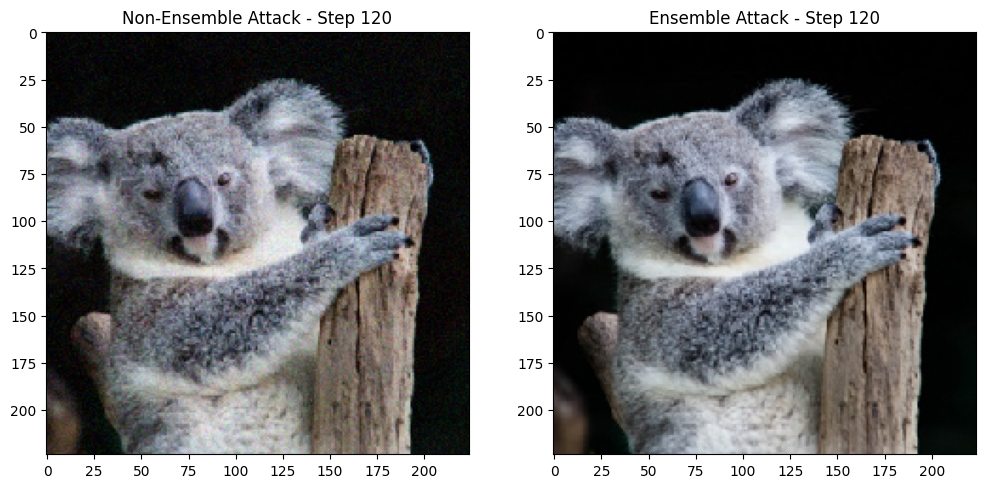

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.34s/it]


Step 130: Non-Ensemble L2 error 3062.502197265625, Class 866, Non-Ensemble Time 29.4304 seconds
Step 130: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.2621 seconds


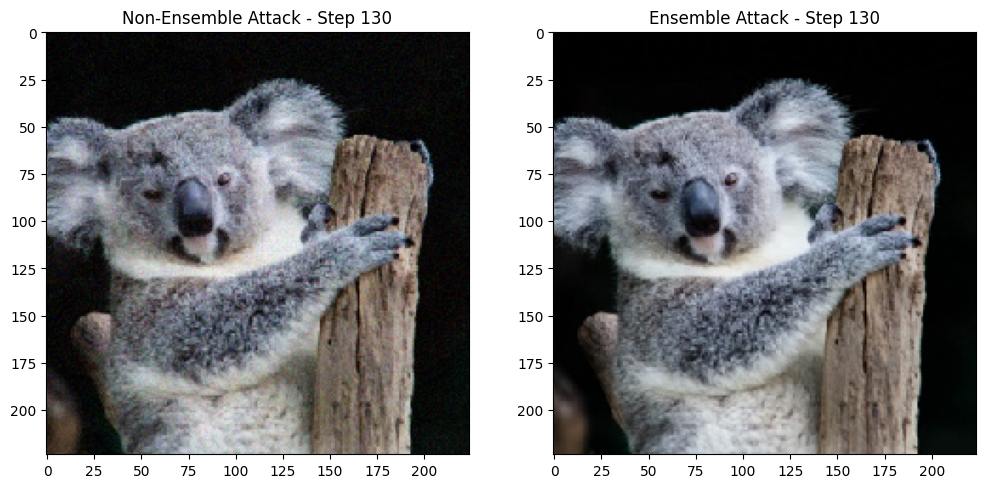

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.22s/it]


Step 140: Non-Ensemble L2 error 2752.234619140625, Class 866, Non-Ensemble Time 29.4775 seconds
Step 140: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.2617 seconds


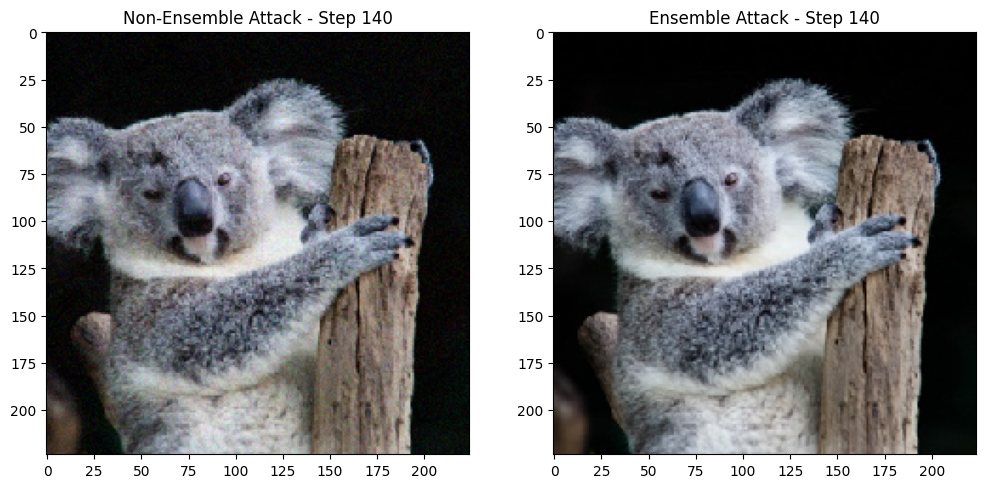

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.26s/it]


Step 150: Non-Ensemble L2 error 2496.9853515625, Class 866, Non-Ensemble Time 32.0044 seconds
Step 150: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.2761 seconds


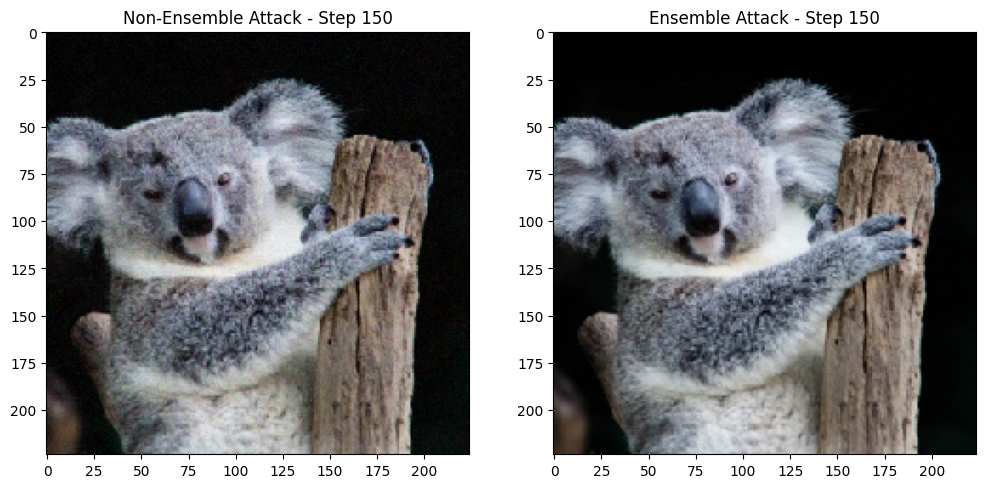

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.34s/it]


Step 160: Non-Ensemble L2 error 2287.46435546875, Class 866, Non-Ensemble Time 31.2753 seconds
Step 160: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.2430 seconds


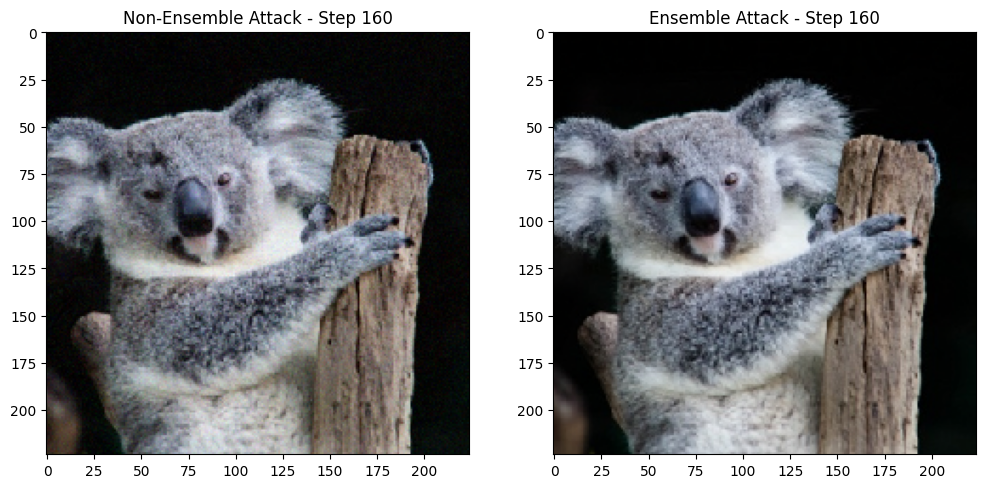

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.19s/it]


Step 170: Non-Ensemble L2 error 2093.823974609375, Class 866, Non-Ensemble Time 31.4196 seconds
Step 170: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.1150 seconds


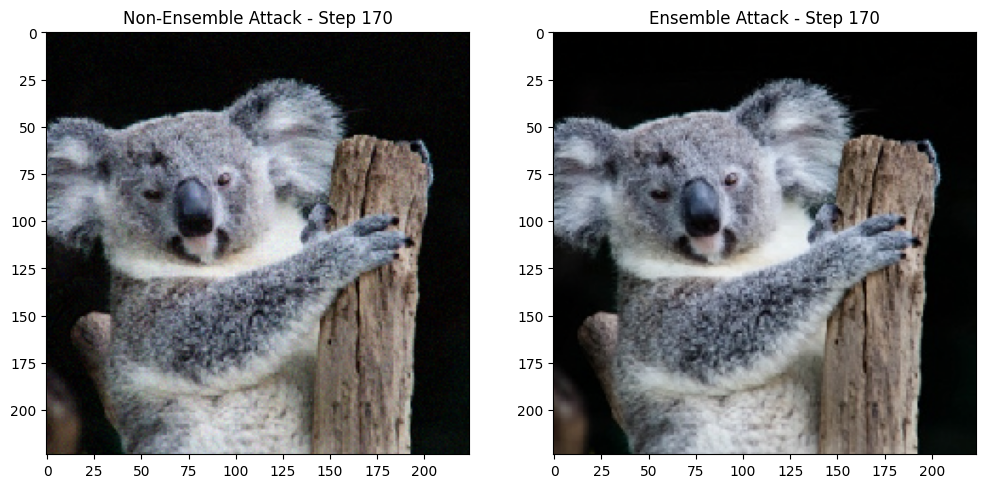

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.93s/it]


Step 180: Non-Ensemble L2 error 1925.8072509765625, Class 866, Non-Ensemble Time 33.6882 seconds
Step 180: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.8059 seconds


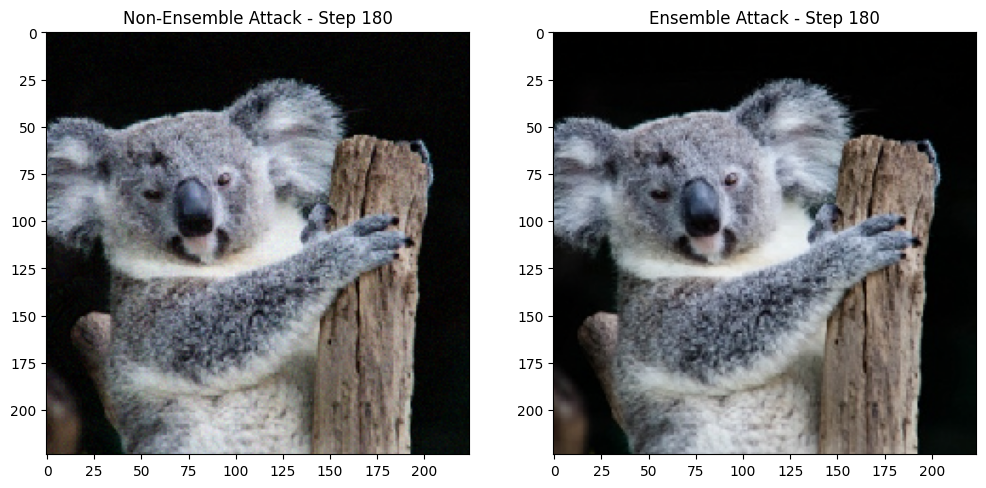

HopSkipJump: 100%|██████████| 1/1 [00:06<00:00,  6.79s/it]


Step 190: Non-Ensemble L2 error 1796.4361572265625, Class 866, Non-Ensemble Time 33.3920 seconds
Step 190: Ensemble L2 error 65.05237579345703, Class 105, Ensemble Time 8.9018 seconds


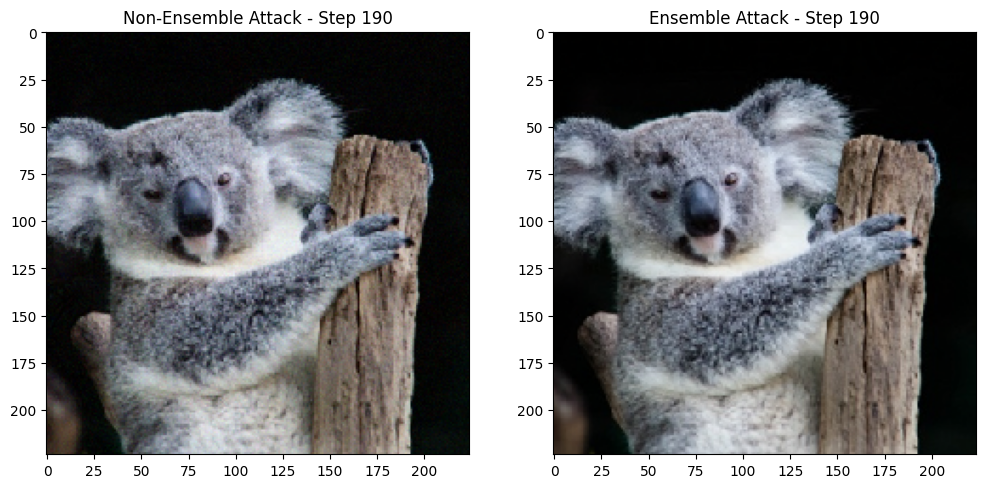

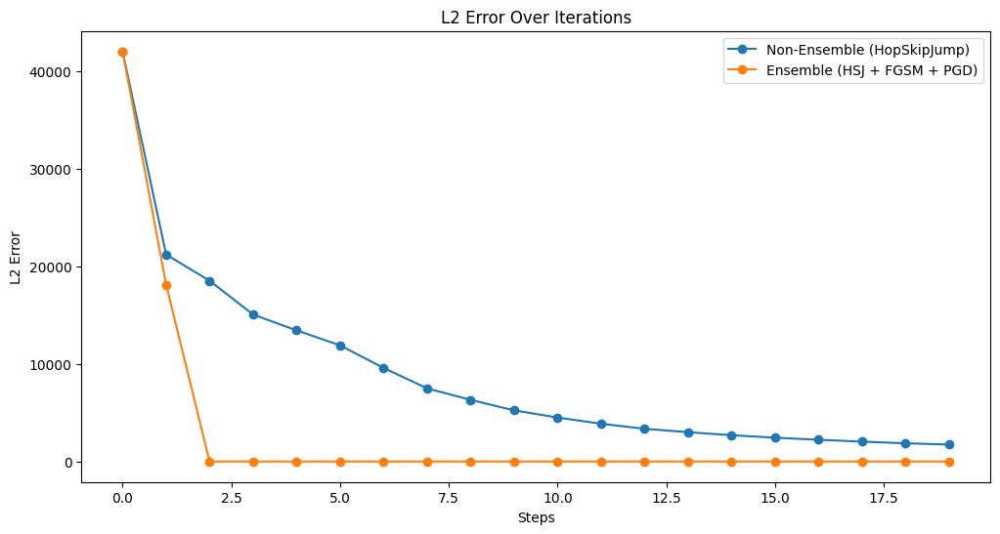

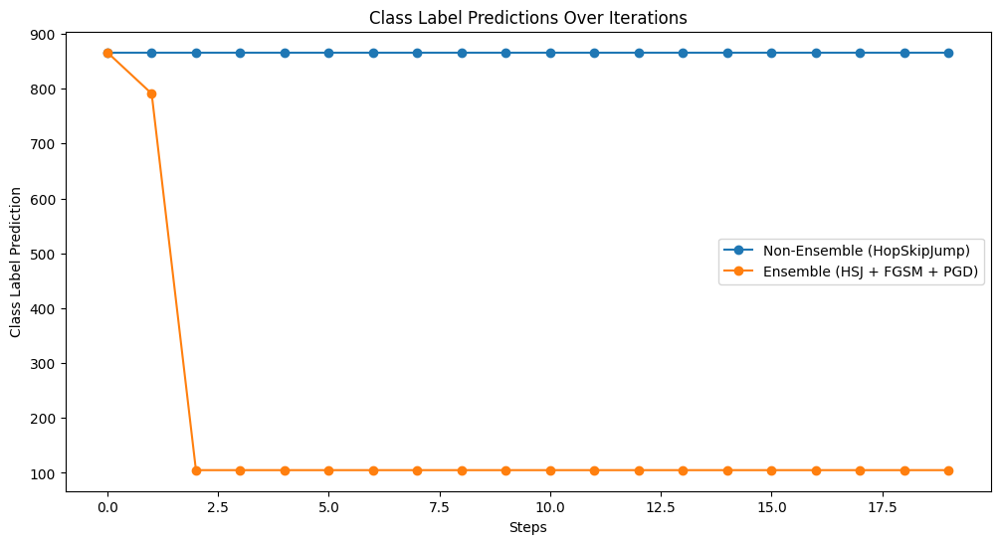

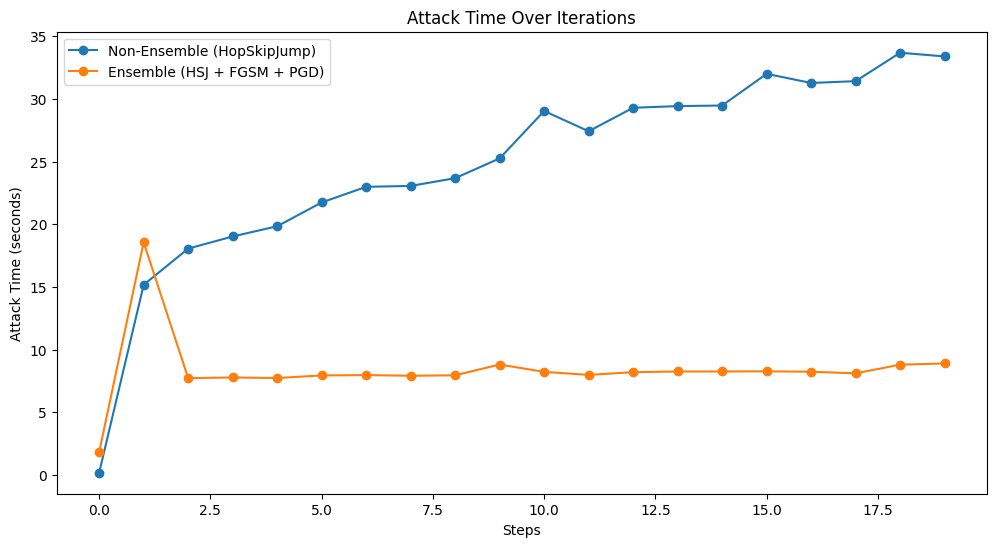

In [ ]:
attack_hopskipjump = HopSkipJump(classifier=classifier, targeted=True, max_iter=0, max_eval=1000, init_eval=10)
attack_fgsm = FastGradientMethod(estimator=classifier, eps=0.1)
attack_pgd = ProjectedGradientDescent(estimator=classifier, eps=0.1, eps_step=0.01, max_iter=10)

# Attack Parameters
hsj_max_iter = 10  # Iteration step for HopSkipJump
num_steps = 20  # Number of steps to iterate

mask = np.random.binomial(n=1, p=0.9, size=np.prod(target_image.shape))
mask = mask.reshape(target_image.shape)

# For ensemble attack (HopSkipJump + FGSM + PGD)
x_adv_ensemble = np.array([init_image])

# For non-ensemble attack (HopSkipJump only)
x_adv_non_ensemble = np.array([init_image])

# Data storage for plotting
errors_ensemble = []
errors_non_ensemble = []
class_labels_ensemble = []
class_labels_non_ensemble = []
times_ensemble = []
times_non_ensemble = []

# Iterative attack process
for i in range(num_steps):
    # Non-Ensemble Attack: HopSkipJump only
    start_time_non_ensemble = time.time()
    x_adv_non_ensemble = attack_hopskipjump.generate(x=np.array([target_image]), y=to_categorical([866], 1000), x_adv_init=x_adv_non_ensemble, resume=True, mask=mask)
    end_time_non_ensemble = time.time()
    time_non_ensemble = end_time_non_ensemble - start_time_non_ensemble
    
    # Ensemble Attack: HopSkipJump + FGSM + PGD
    start_time_ensemble = time.time()
    x_adv_ensemble = attack_hopskipjump.generate(x=np.array([target_image]), y=to_categorical([866], 1000), x_adv_init=x_adv_ensemble, resume=True, mask=mask)
    x_adv_ensemble = attack_fgsm.generate(x=x_adv_ensemble)
    x_adv_ensemble = attack_pgd.generate(x=x_adv_ensemble)
    end_time_ensemble = time.time()
    time_ensemble = end_time_ensemble - start_time_ensemble
    
    # Calculate L2 error
    l2_error_non_ensemble = np.linalg.norm(np.reshape(x_adv_non_ensemble[0] - target_image, [-1]))
    l2_error_ensemble = np.linalg.norm(np.reshape(x_adv_ensemble[0] - target_image, [-1]))
    
    # Get class label predictions
    class_label_non_ensemble = np.argmax(classifier.predict(x_adv_non_ensemble)[0])
    class_label_ensemble = np.argmax(classifier.predict(x_adv_ensemble)[0])
    
    # Store metrics
    errors_non_ensemble.append(l2_error_non_ensemble)
    errors_ensemble.append(l2_error_ensemble)
    class_labels_non_ensemble.append(class_label_non_ensemble)
    class_labels_ensemble.append(class_label_ensemble)
    times_non_ensemble.append(time_non_ensemble)
    times_ensemble.append(time_ensemble)
    
    # Print out progress
    print(f"Step {i * hsj_max_iter}: Non-Ensemble L2 error {l2_error_non_ensemble}, Class {class_label_non_ensemble}, Non-Ensemble Time {time_non_ensemble:.4f} seconds")
    print(f"Step {i * hsj_max_iter}: Ensemble L2 error {l2_error_ensemble}, Class {class_label_ensemble}, Ensemble Time {time_ensemble:.4f} seconds")
    
    # Show images
    plt.figure(figsize=(12, 6))
    
    plt.subplot(1, 2, 1)
    plt.title(f"Non-Ensemble Attack - Step {i * hsj_max_iter}")
    plt.imshow(x_adv_non_ensemble[0].astype(np.uint8))
    
    plt.subplot(1, 2, 2)
    plt.title(f"Ensemble Attack - Step {i * hsj_max_iter}")
    plt.imshow(x_adv_ensemble[0].astype(np.uint8))
    
    plt.show(block=False)
    
    # Increment HopSkipJump max iterations
    attack_hopskipjump.max_iter = hsj_max_iter

# Plotting L2 Error Comparison
plt.figure(figsize=(12, 6))
plt.plot(range(num_steps), errors_non_ensemble, label='Non-Ensemble (HopSkipJump)', marker='o')
plt.plot(range(num_steps), errors_ensemble, label='Ensemble (HSJ + FGSM + PGD)', marker='o')
plt.xlabel('Steps')
plt.ylabel('L2 Error')
plt.title('L2 Error Over Iterations')
plt.legend()
plt.show()

# Plotting Class Label Predictions
plt.figure(figsize=(12, 6))
plt.plot(range(num_steps), class_labels_non_ensemble, label='Non-Ensemble (HopSkipJump)', marker='o')
plt.plot(range(num_steps), class_labels_ensemble, label='Ensemble (HSJ + FGSM + PGD)', marker='o')
plt.xlabel('Steps')
plt.ylabel('Class Label Prediction')
plt.title('Class Label Predictions Over Iterations')
plt.legend()
plt.show()

# Plotting Attack Time Comparison
plt.figure(figsize=(12, 6))
plt.plot(range(num_steps), times_non_ensemble, label='Non-Ensemble (HopSkipJump)', marker='o')
plt.plot(range(num_steps), times_ensemble, label='Ensemble (HSJ + FGSM + PGD)', marker='o')
plt.xlabel('Steps')
plt.ylabel('Attack Time (seconds)')
plt.title('Attack Time Over Iterations')
plt.legend()
plt.show()